In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import sys
import glob
import re
import platform
import importlib
import netCDF4
import multiprocessing as mp
import itertools
import scipy.stats as stats
import seaborn as sns
import rasterio
from rasterio.plot import show
from matplotlib.colors import ListedColormap
from matplotlib import cm, colors
from matplotlib.colors import Normalize
from scipy.interpolate import interpn
import matplotlib.ticker as ticker

user_name = input("Your home folder's user name?")

if platform.system() == 'Darwin':  # macOS
    base_FP = f'/Users/{user_name}/data'
    cpuserver_data_FP = f'/Users/{user_name}/cpuserver_data'
elif platform.system() == 'Linux':
    base_FP = f'/home/{user_name}/data'
    cpuserver_data_FP = f'/home/{user_name}/cpuserver_data'
else:
    base_FP = '/data'
    cpuserver_data_FP = '/data'
print(base_FP, cpuserver_data_FP)
sys.path.append(base_FP + '/python_modules')

#hydroAI libs
import develop_HydroAI.HydroAI.HLS as hHLS
import develop_HydroAI.HydroAI.Plot as hPlot
import HydroAI.Data as hData
import HydroAI.Grid as hGrid
importlib.reload(hHLS);
importlib.reload(hPlot);
importlib.reload(hData);
importlib.reload(hGrid);

Your home folder's user name? subin


/home/subin/data /home/subin/cpuserver_data


/home/subin/miniconda3/envs/cuml_env/lib/python3.10/site-packages/optuna/study/_optimize.py:20: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from optuna import progress_bar as pbar_module


In [2]:
save_path = f'{cpuserver_data_FP}/HLS/Korea/UHI_project_L30/2013_2024'

In [3]:
def plot_kde_scatter_log_count(y_true, y_pred, fontsize=20, global_min=None, global_max=None, 
                               title='', x_label='True Values', y_label='Predicted Values', save_fig_path=None):
    plt.rc('font', family='Serif')

    if global_min == None:
        global_min = min(min(y_true), min(y_pred))
    if global_max == None:
        global_max = max(max(y_true), max(y_pred))

    """
    This function creates a scatter plot to evaluate ML model performance with respect to train and test dataset.
    """
    def bin_count_scatter(x, y, ax=None, sort=True, bins=20, **kwargs):
        """
        Scatter plot colored by the number of points in a bin with a threshold at 80% and exceeding values in yellow
        """
        if ax is None:
            fig, ax = plt.subplots()
        data, x_e, y_e = np.histogram2d(x, y, bins=bins)  # Calculate bin counts
        z = interpn((0.5*(x_e[1:] + x_e[:-1]), 0.5*(y_e[1:]+y_e[:-1])), data, np.vstack([x,y]).T, method="splinef2d", bounds_error=False)

        # To be sure to plot all data
        z[np.where(np.isnan(z))] = 0.0

        # Sort the points by number of points in each bin, so that the densest points are plotted last
        if sort:
            idx = z.argsort()
            x, y, z = x[idx], y[idx], z[idx]

        # Calculate 80% threshold of bin counts
        max_z = np.max(z)
        threshold = 0.8 * max_z

        # Set up normalization with LogNorm and threshold
        norm = colors.LogNorm(vmin=1, vmax=threshold)  # vmin set to 1 to avoid issues with log(0)

        # Set up colormap
        cmap = cm.viridis
        cmap.set_over('yellow')

        # Scatter plot
        sc = ax.scatter(x, y, c=z, norm=norm, cmap=cmap, **kwargs)
        cbar = plt.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax, extend='max')
        sc.set_clim(1, threshold)
        cbar.cmap.set_over('yellow')

        # Adjust the color bar ticks to represent bin counts in log scale
        log_ticks = np.logspace(np.log10(1), np.log10(threshold), num=5)
        cbar.set_ticks(log_ticks)
        cbar.set_ticklabels([f'{int(val)}' for val in log_ticks])
        cbar.ax.set_title('Bin Counts', fontsize=fontsize)

        return ax

    # Plotting training and test results with bin count scatter
    fig, ax = plt.subplots(1, 1, figsize=(8, 6))

    # Define the ticks for x and y axis
    x_ticks = np.linspace(global_min, global_max, 5)
    y_ticks = np.linspace(global_min, global_max, 5)

    # Training results
    mae_train = np.mean(np.abs(y_true - y_pred))
    ax_train = bin_count_scatter(y_true, y_pred, ax=ax, bins=[30, 30], s=10)
    ax.plot([global_min, global_max], [global_min, global_max], 'k--', lw=2)
    ax.set_xlabel(f'{x_label}', fontsize=fontsize)
    ax.set_ylabel(f'{y_label}', fontsize=fontsize)
    ax.set_title(f'{title}', fontsize=fontsize)
    ax.grid(True)
    ax.set_xticks(x_ticks)
    ax.set_yticks(y_ticks)
    # Display MAE in upper left
    ax.text(0.05, 0.95, f'MAE = {mae_train:.6f}', transform=ax.transAxes,
                 fontsize=fontsize, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8))

    plt.tight_layout()

    if save_fig_path != None:
        plt.savefig(save_fig_path, dpi=300)
    
    plt.show()

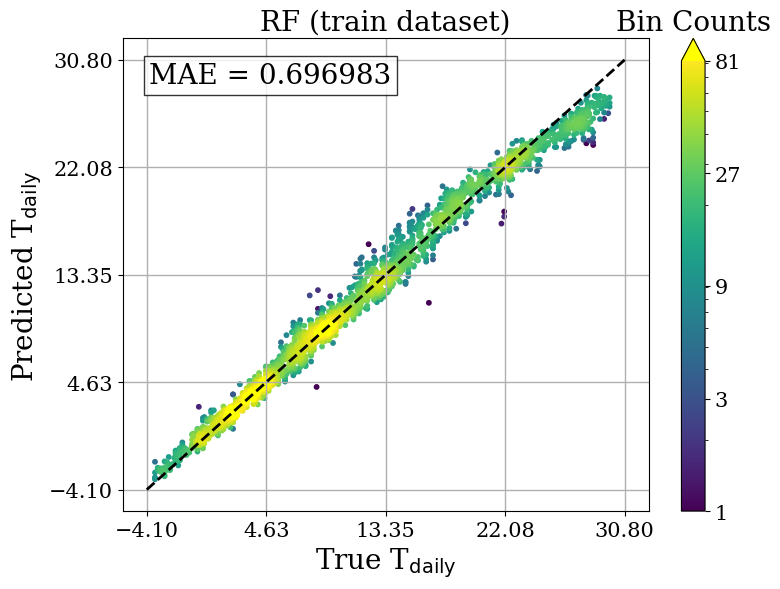

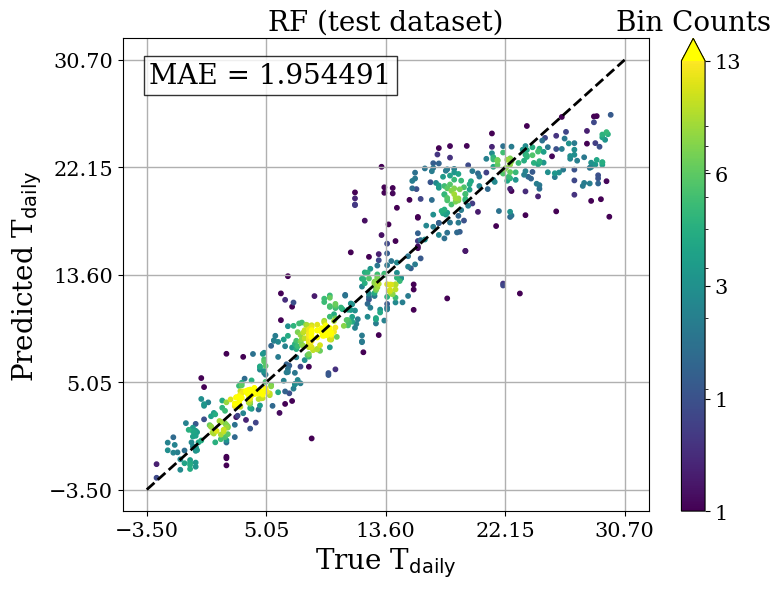

In [62]:
model_name = 'RF'
df_pred_true_train = pd.read_csv(f'{save_path}/{model_name}_predtrue_train.csv')
df_pred_true_test  = pd.read_csv(f'{save_path}/{model_name}_predtrue_test.csv')

y_true_train = df_pred_true_train['y_true_train']
y_pred_train = df_pred_true_train['y_pred_train']

y_true_test = df_pred_true_test['y_true_test']
y_pred_test = df_pred_true_test['y_pred_test']

plot_kde_scatter_log_count(y_true_train, y_pred_train,
                          title=f'{model_name} (train dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures/{model_name}_train.png')
plot_kde_scatter_log_count(y_true_test, y_pred_test,
                          title=f'{model_name} (test dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures/{model_name}_test.png')

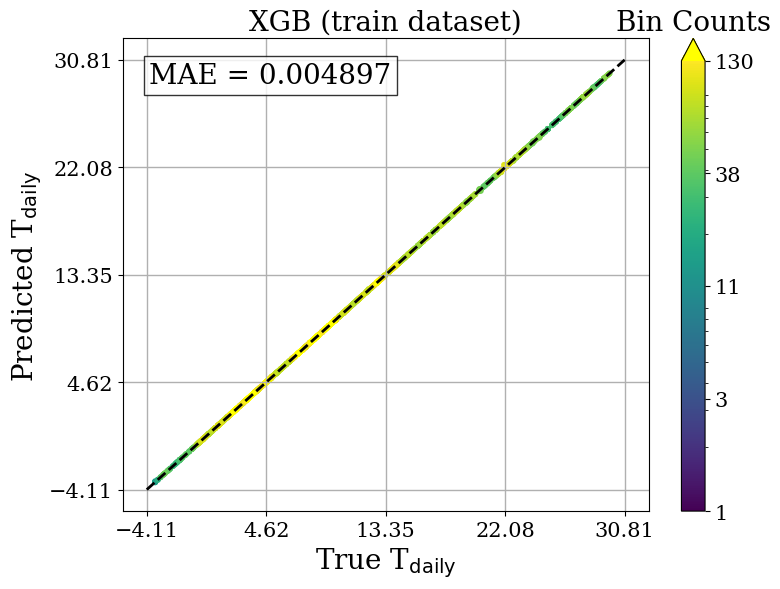

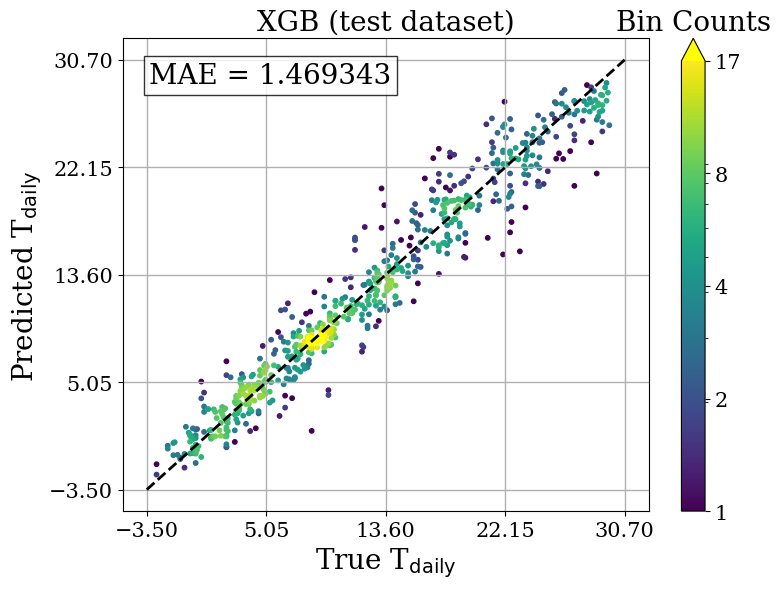

In [63]:
model_name = 'XGB'
df_pred_true_train = pd.read_csv(f'{save_path}/{model_name}_predtrue_train.csv')
df_pred_true_test  = pd.read_csv(f'{save_path}/{model_name}_predtrue_test.csv')

y_true_train = df_pred_true_train['y_true_train']
y_pred_train = df_pred_true_train['y_pred_train']

y_true_test = df_pred_true_test['y_true_test']
y_pred_test = df_pred_true_test['y_pred_test']

plot_kde_scatter_log_count(y_true_train, y_pred_train,
                          title=f'{model_name} (train dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures/{model_name}_train.png')
plot_kde_scatter_log_count(y_true_test, y_pred_test,
                          title=f'{model_name} (test dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures/{model_name}_test.png')

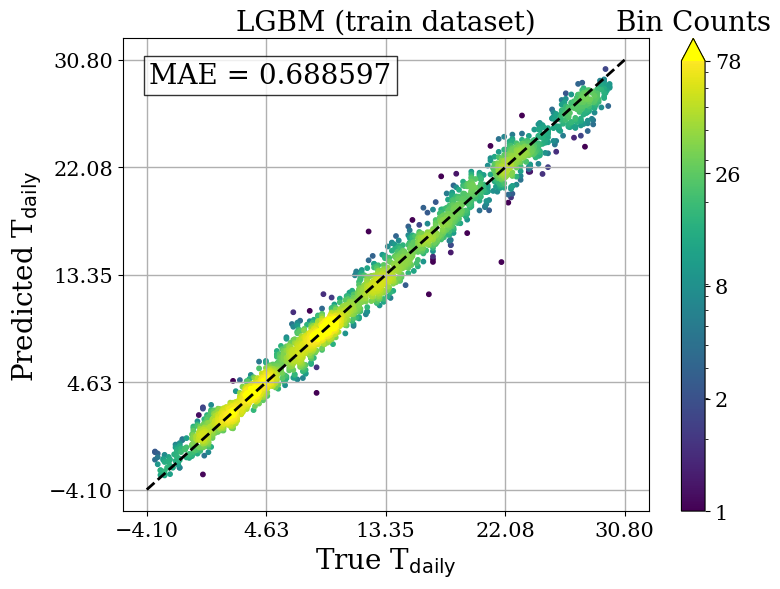

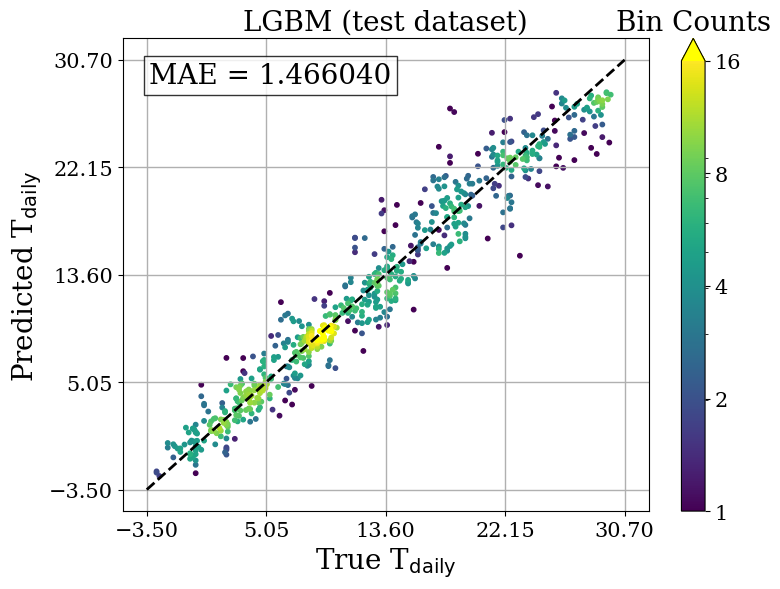

In [64]:
model_name = 'LGBM'
df_pred_true_train = pd.read_csv(f'{save_path}/{model_name}_predtrue_train.csv')
df_pred_true_test  = pd.read_csv(f'{save_path}/{model_name}_predtrue_test.csv')

y_true_train = df_pred_true_train['y_true_train']
y_pred_train = df_pred_true_train['y_pred_train']

y_true_test = df_pred_true_test['y_true_test']
y_pred_test = df_pred_true_test['y_pred_test']

plot_kde_scatter_log_count(y_true_train, y_pred_train,
                          title=f'{model_name} (train dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures/{model_name}_train.png')
plot_kde_scatter_log_count(y_true_test, y_pred_test,
                          title=f'{model_name} (test dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures/{model_name}_test.png')

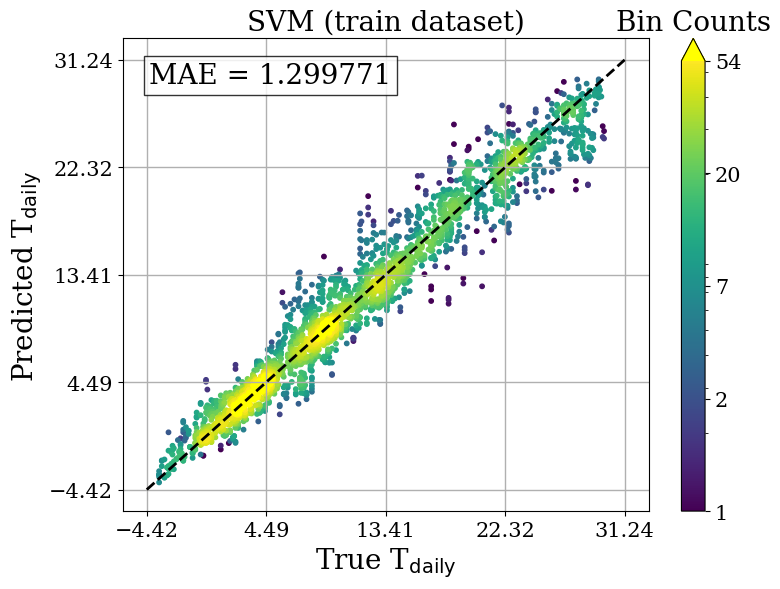

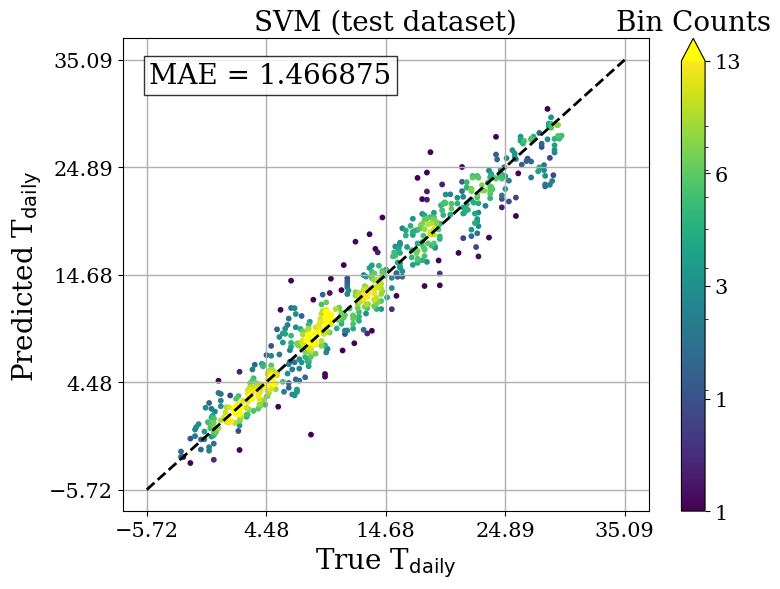

In [65]:
model_name = 'SVM'
df_pred_true_train = pd.read_csv(f'{save_path}/{model_name}_predtrue_train.csv')
df_pred_true_test  = pd.read_csv(f'{save_path}/{model_name}_predtrue_test.csv')

y_true_train = df_pred_true_train['y_true_train']
y_pred_train = df_pred_true_train['y_pred_train']

y_true_test = df_pred_true_test['y_true_test']
y_pred_test = df_pred_true_test['y_pred_test']

plot_kde_scatter_log_count(y_true_train, y_pred_train,
                          title=f'{model_name} (train dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures/{model_name}_train.png')
plot_kde_scatter_log_count(y_true_test, y_pred_test,
                          title=f'{model_name} (test dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures/{model_name}_test.png')

In [4]:
for i, year in enumerate(range(2013, 2023 + 1)):
    with netCDF4.Dataset(f'{save_path}/ave_temp_recons_{year}.nc') as nc_data:
        vars_list = list(nc_data.variables.keys())
        latitude = nc_data['latitude'][:].data
        longitude = nc_data['longitude'][:].data
        dates = nc_data['dates'][:].data

        RF = nc_data['RF'][:].data
        XGB = nc_data['XGB'][:].data
        LGBM = nc_data['LGBM'][:].data
        SVM = nc_data['SVM'][:].data
    
    # Extract summer values
    season_indices = [i for i, date in enumerate(dates) if str(date)[4:6] in ['06', '07', '08']]
    print(year, dates[season_indices])
    
    RF_year_season = RF[:, :, season_indices]
    XGB_year_season = XGB[:, :, season_indices]
    LGBM_year_season = LGBM[:, :, season_indices]
    SVM_year_season = SVM[:, :, season_indices]
    
    if i != 0:
        RF_year_season = np.concatenate( [RF_year_season_old, RF_year_season], axis=2 )
        XGB_year_season = np.concatenate( [XGB_year_season_old, XGB_year_season], axis=2 )
        LGBM_year_season = np.concatenate( [LGBM_year_season_old, LGBM_year_season], axis=2 )
        SVM_year_season = np.concatenate( [SVM_year_season_old, SVM_year_season], axis=2 )
    
    RF_year_season_old = RF_year_season
    XGB_year_season_old = XGB_year_season
    LGBM_year_season_old = LGBM_year_season
    SVM_year_season_old = SVM_year_season

del RF; del XGB; del LGBM; del SVM
del RF_year_season_old
del XGB_year_season_old
del LGBM_year_season_old
del SVM_year_season_old

2013 [20130628 20130730 20130808 20130815 20130831]
2014 [20140608 20140615 20140624 20140701 20140710 20140726 20140802 20140811
 20140827]
2015 [20150602 20150618 20150627 20150704 20150729 20150805 20150814 20150821
 20150830]
2016 [20160613 20160620 20160629 20160706 20160715 20160722 20160731 20160807
 20160816 20160823]
2017 [20170616 20170623 20170709 20170725 20170803 20170810 20170826]
2018 [20180603 20180610 20180705 20180712 20180721 20180728 20180806 20180813
 20180822 20180829]
2019 [20190613 20190622 20190708 20190715 20190731 20190809 20190816 20190825]
2020 [20200608 20200615 20200701 20200710 20200717 20200726 20200811 20200818
 20200827]
2021 [20210602 20210611 20210627 20210713 20210720 20210729 20210805 20210830]
2022 [20220606 20220613 20220621 20220622 20220630 20220707 20220708 20220715
 20220716 20220723 20220724 20220801 20220808 20220809 20220816 20220817
 20220824 20220825]
2023 [20230601 20230608 20230609 20230616 20230617 20230624 20230625 20230702
 2023070

/tmp/ipykernel_2337365/1408475677.py:1: RuntimeWarning: Mean of empty slice
  RF_mean = np.nanmean(RF_year_season, axis=2)


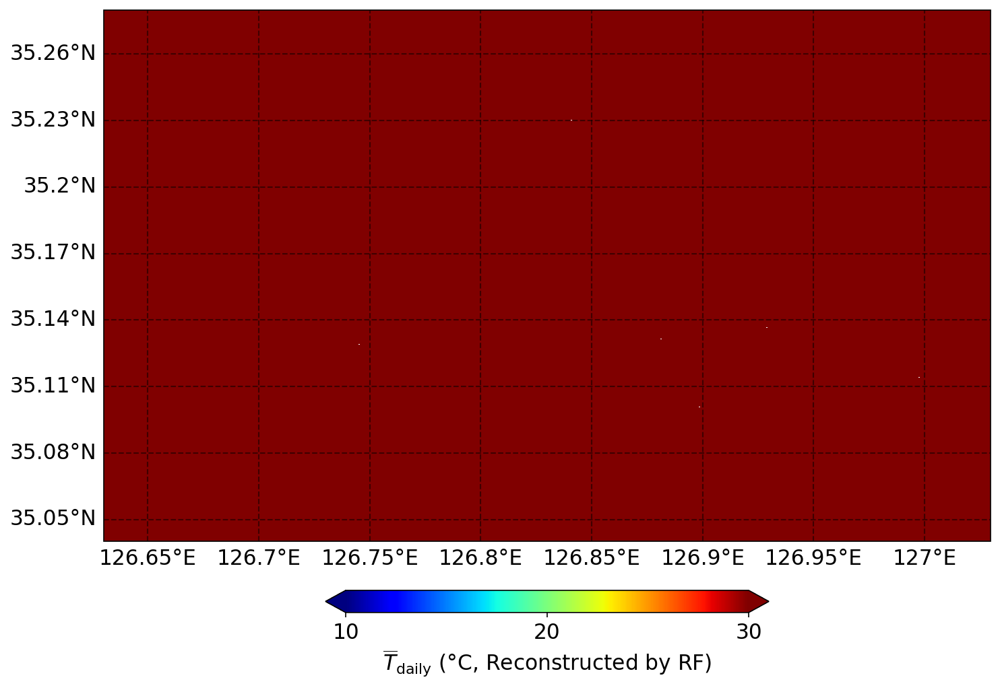

/tmp/ipykernel_2337365/1408475677.py:7: RuntimeWarning: Mean of empty slice
  XGB_mean = np.nanmean(XGB_year_season, axis=2)


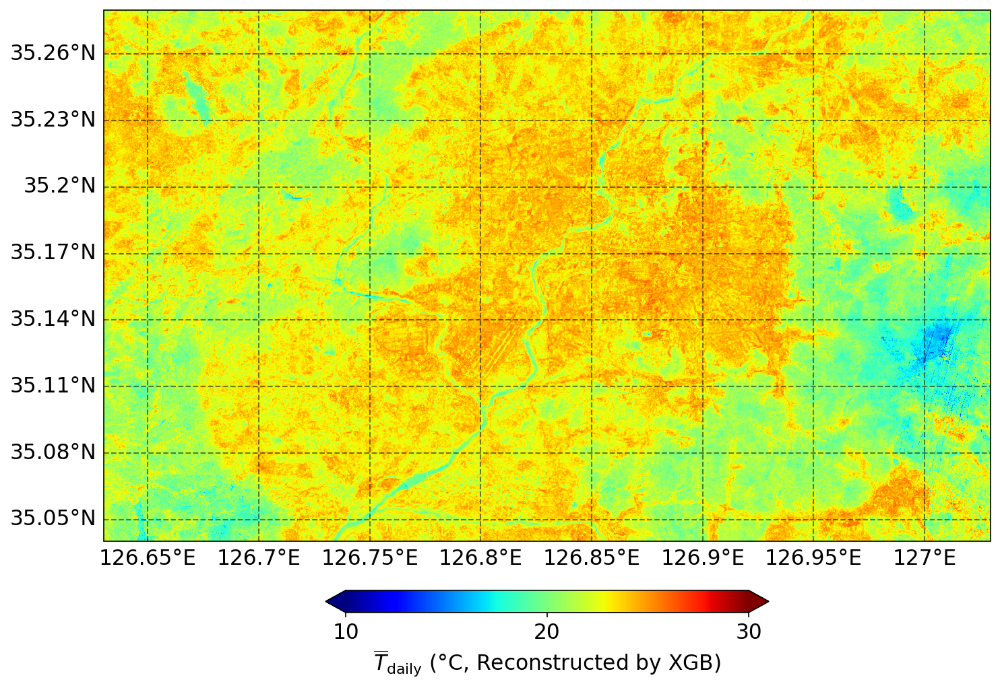

/tmp/ipykernel_2337365/1408475677.py:13: RuntimeWarning: Mean of empty slice
  LGBM_mean = np.nanmean(LGBM_year_season, axis=2)


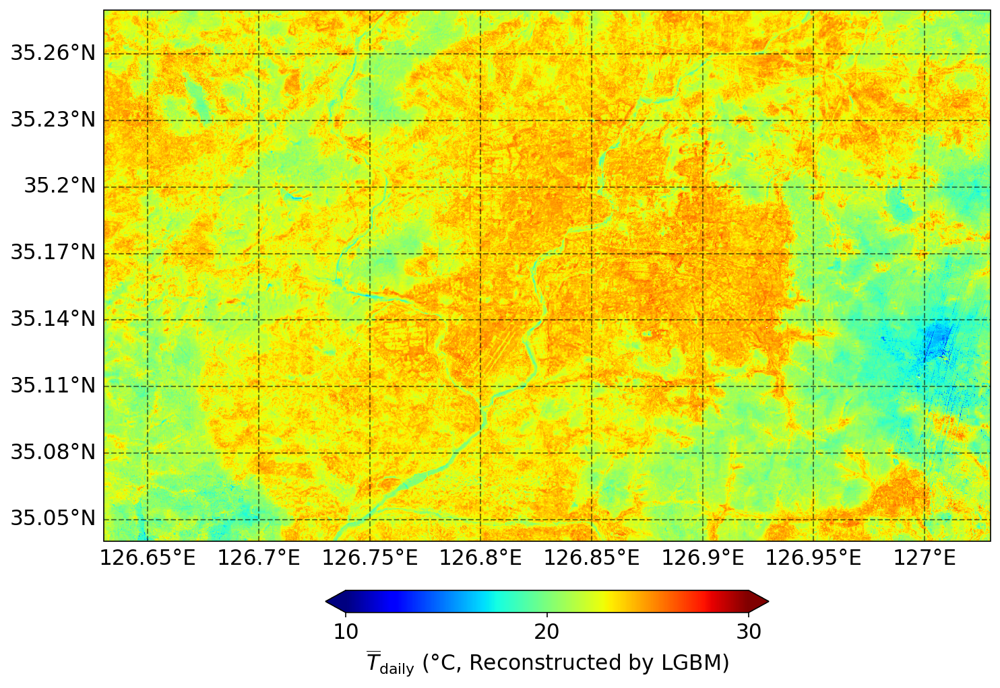

/tmp/ipykernel_2337365/1408475677.py:19: RuntimeWarning: Mean of empty slice
  SVM_mean = np.nanmean(SVM_year_season, axis=2)


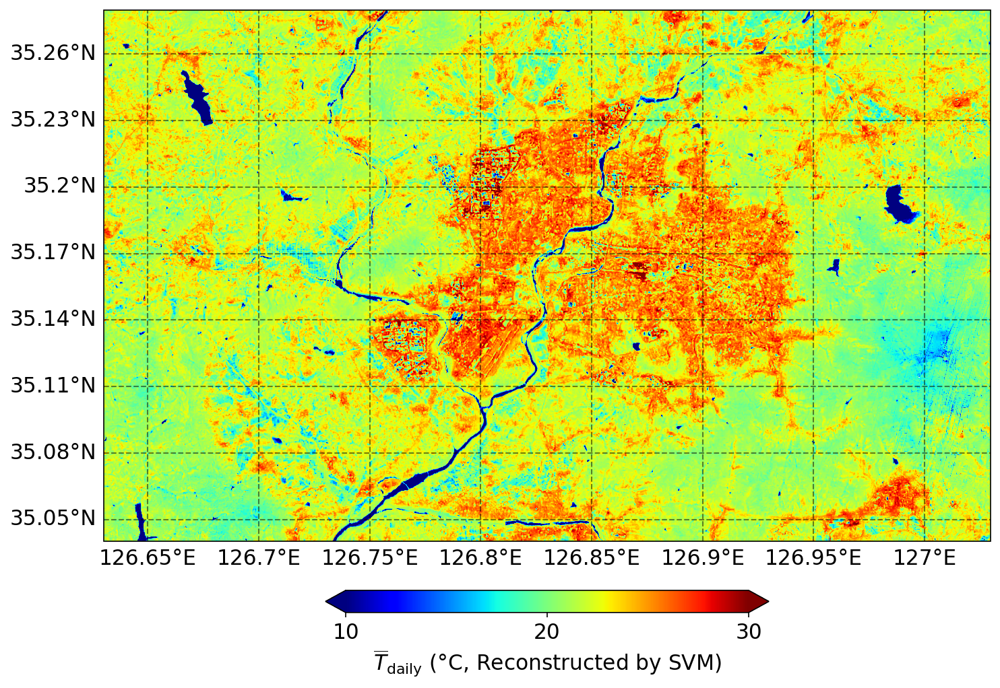

(<Figure size 1500x1500 with 2 Axes>, <GeoAxes: >)

In [13]:
RF_mean = np.nanmean(RF_year_season, axis=2)
hPlot.plot_map(longitude, latitude, RF_mean, 10, 30, label_title=r'$\overline{T}_{\mathrm{daily}}$ ($\degree$C, Reconstructed by RF)',
               cbar_ticks=[10, 20, 30], cbar_extend='both',
               save_fig_path=f'Figures/RF_mean.png',
               projection='PlateCarree')

XGB_mean = np.nanmean(XGB_year_season, axis=2)
hPlot.plot_map(longitude, latitude, XGB_mean, 10, 30, label_title=r'$\overline{T}_{\mathrm{daily}}$ ($\degree$C, Reconstructed by XGB)',
               cbar_ticks=[10, 20, 30], cbar_extend='both',
               save_fig_path=f'Figures/XGB_mean.png',
               projection='PlateCarree')

LGBM_mean = np.nanmean(LGBM_year_season, axis=2)
hPlot.plot_map(longitude, latitude, LGBM_mean, 10, 30, label_title=r'$\overline{T}_{\mathrm{daily}}$ ($\degree$C, Reconstructed by LGBM)',
               cbar_ticks=[10, 20, 30], cbar_extend='both',
               save_fig_path=f'Figures/LGBM_mean.png',
               projection='PlateCarree')

SVM_mean = np.nanmean(SVM_year_season, axis=2)
hPlot.plot_map(longitude, latitude, SVM_mean, 10, 30, label_title=r'$\overline{T}_{\mathrm{daily}}$ ($\degree$C, Reconstructed by SVM)',
               cbar_ticks=[10, 20, 30], cbar_extend='both',
               save_fig_path=f'Figures/SVM_mean.png',
               projection='PlateCarree')

/home/subin/miniconda3/envs/cuml_env/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


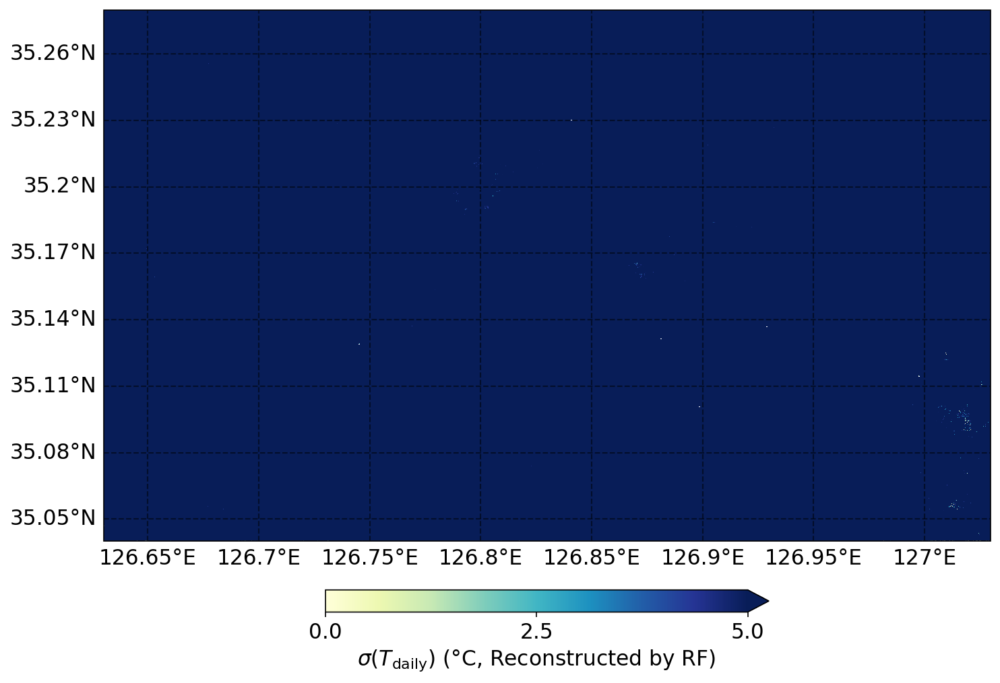

/home/subin/miniconda3/envs/cuml_env/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


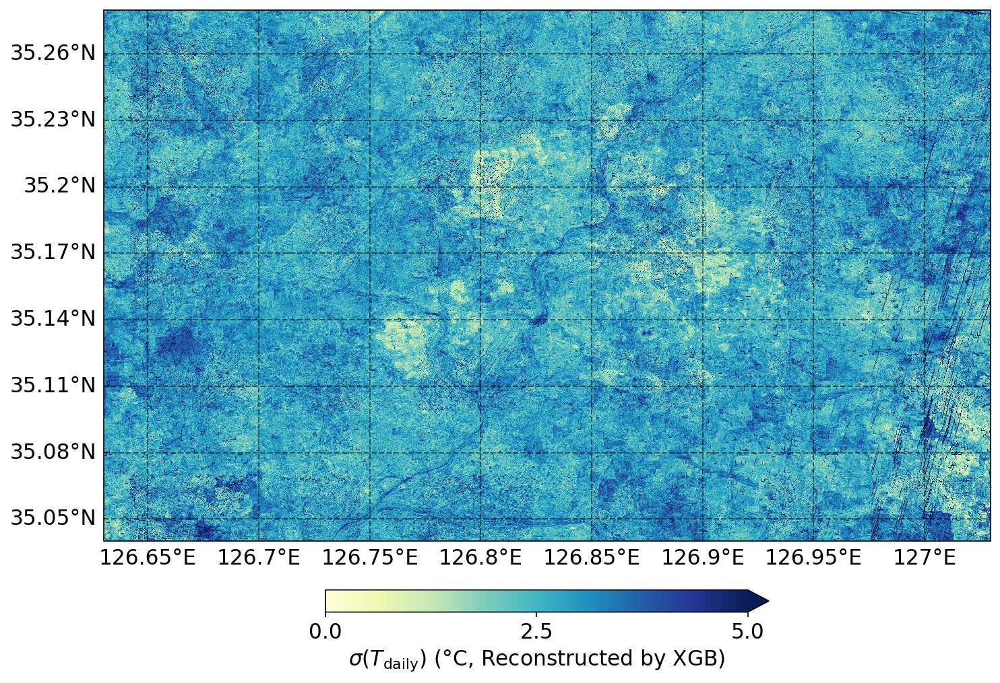

/home/subin/miniconda3/envs/cuml_env/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


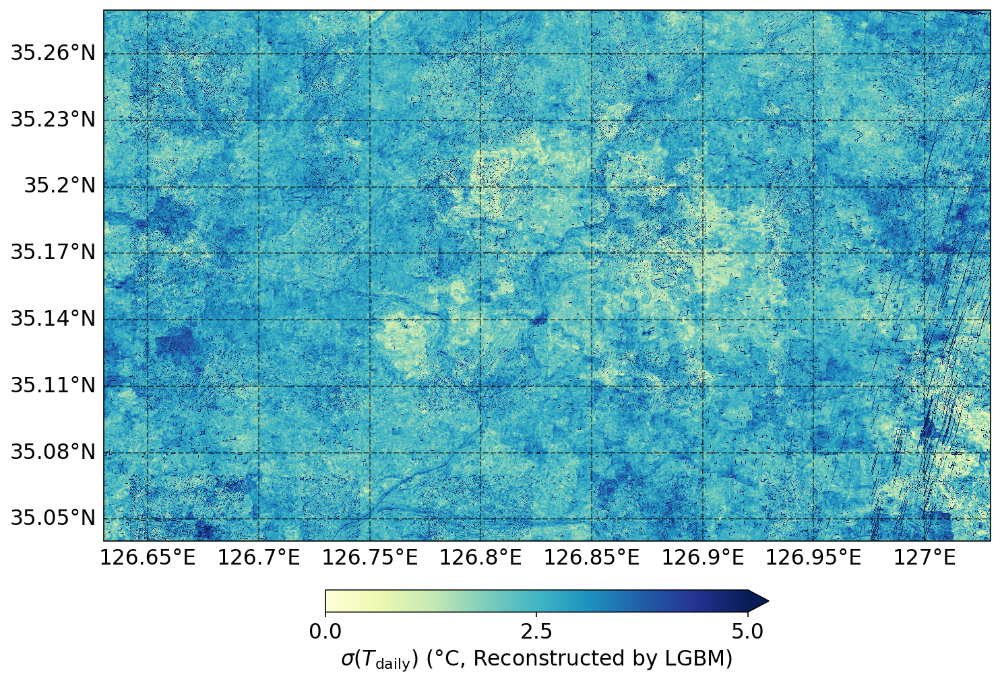

/home/subin/miniconda3/envs/cuml_env/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


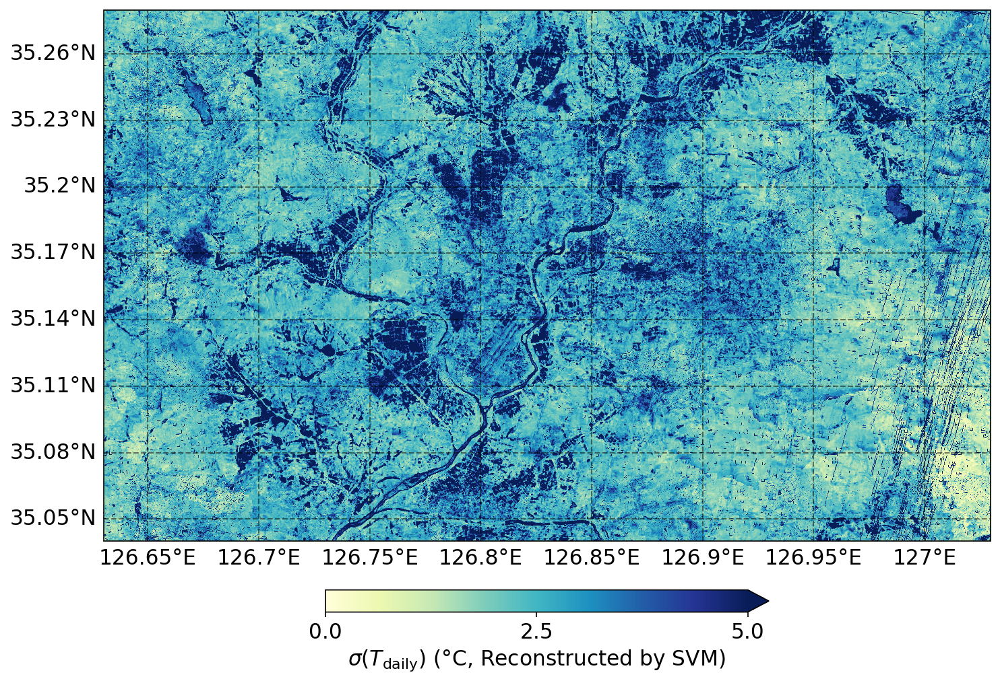

(<Figure size 1500x1500 with 2 Axes>, <GeoAxes: >)

In [12]:
RF_std = np.nanstd(RF_year_season, axis=2)
hPlot.plot_map(longitude, latitude, RF_std, 0, 5, label_title=r'$\sigma(T_{\mathrm{daily}})$ ($\degree$C, Reconstructed by RF)',
               cbar_ticks=[0, 2.5, 5], cbar_extend='max', cmap='YlGnBu',
               save_fig_path=f'Figures/RF_std.png',
               projection='PlateCarree')

XGB_std = np.nanstd(XGB_year_season, axis=2)
hPlot.plot_map(longitude, latitude, XGB_std, 0, 5, label_title=r'$\sigma(T_{\mathrm{daily}})$ ($\degree$C, Reconstructed by XGB)',
               cbar_ticks=[0, 2.5, 5], cbar_extend='max', cmap='YlGnBu',
               save_fig_path=f'Figures/XGB_std.png',
               projection='PlateCarree')

LGBM_std = np.nanstd(LGBM_year_season, axis=2)
hPlot.plot_map(longitude, latitude, LGBM_std, 0, 5, label_title=r'$\sigma(T_{\mathrm{daily}})$ ($\degree$C, Reconstructed by LGBM)',
               cbar_ticks=[0, 2.5, 5], cbar_extend='max', cmap='YlGnBu',
               save_fig_path=f'Figures/LGBM_std.png',
               projection='PlateCarree')

SVM_std = np.nanstd(SVM_year_season, axis=2)
hPlot.plot_map(longitude, latitude, SVM_std, 0, 5, label_title=r'$\sigma(T_{\mathrm{daily}})$ ($\degree$C, Reconstructed by SVM)',
               cbar_ticks=[0, 2.5, 5], cbar_extend='max', cmap='YlGnBu',
               save_fig_path=f'Figures/SVM_std.png',
               projection='PlateCarree')

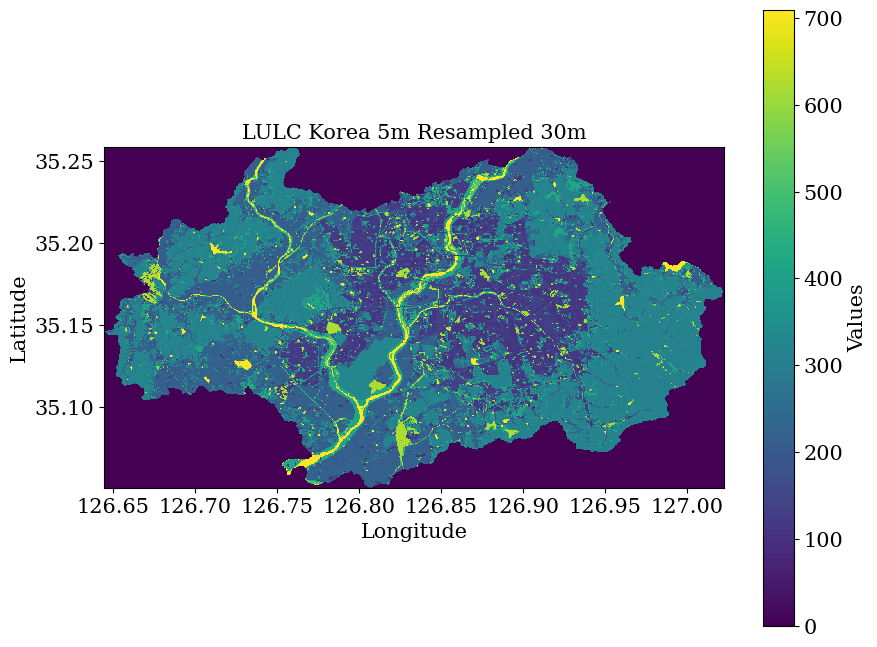

In [171]:
# Open the GeoTIFF file
#file_path = f'{cpuserver_data_FP}/LULC/ROK/South_Korea/LULC_Korea_5m_resampled_30m.tif'
file_path = f'{cpuserver_data_FP}/LULC/ROK/Gwangju/Gwangju_30m.tif'

with rasterio.open(file_path) as src:
    # Read the data from the first band (assuming single band data)
    LULC_data = src.read(1)
    
    # Get the coordinates for the pixels
    transform = src.transform
    width = src.width
    height = src.height

    # Get the bounds (left, bottom, right, top)
    bounds = src.bounds
    
    # Generate latitude and longitude for each pixel
    lon = np.linspace(bounds.left, bounds.right, width)
    lat = np.linspace(bounds.top, bounds.bottom, height)
    
    # Create meshgrid for plotting
    lon_grid, lat_grid = np.meshgrid(lon, lat)

    # Plotting
    plt.figure(figsize=(10, 8))
    plt.pcolormesh(lon_grid, lat_grid, LULC_data, cmap='viridis')
    plt.colorbar(label="Values")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.title("LULC Korea 5m Resampled 30m")
    plt.gca().set_aspect('equal', adjustable='box')
    plt.show()

In [123]:
latitude_ud = np.flipud(latitude)
Resampled_LULC  = hData.Resampling(longitude, latitude_ud, lon_grid, lat_grid, LULC_data, agg_method='mode', mag_factor=2)
np.save('Resampled_LULC.npy', Resampled_LULC)

In [124]:
np.shape(Resampled_LULC)

(800, 1333)

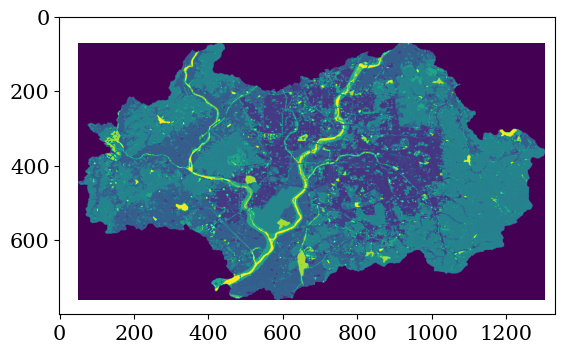

In [125]:
plt.imshow(Resampled_LULC)

In [126]:
#Resampled_LULC = Resampled_LULC.astype('int64')
np.unique(Resampled_LULC)

array([  0., 110., 120., 130., 140., 150., 160., 210., 220., 230., 240.,
       250., 310., 320., 330., 410., 420., 510., 610., 620., 710.,  nan])

In [157]:
!apt-get update -qq
!apt-get install -qq fonts-nanum

# 설치된 폰트를 확인합니다.
!fc-list :lang=ko

E: Could not open lock file /var/lib/apt/lists/lock - open (13: Permission denied)
E: Unable to lock directory /var/lib/apt/lists/
W: Problem unlinking the file /var/cache/apt/pkgcache.bin - RemoveCaches (13: Permission denied)
W: Problem unlinking the file /var/cache/apt/srcpkgcache.bin - RemoveCaches (13: Permission denied)
E: Could not open lock file /var/lib/dpkg/lock-frontend - open (13: Permission denied)
E: Unable to acquire the dpkg frontend lock (/var/lib/dpkg/lock-frontend), are you root?
/usr/share/fonts/X11/misc/18x18ja.pcf.gz: Fixed:style=ja
/usr/share/fonts/opentype/noto/NotoSerifCJK-Bold.ttc: Noto Serif CJK SC:style=Bold
/usr/share/fonts/opentype/noto/NotoSerifCJK-Bold.ttc: Noto Serif CJK TC:style=Bold
/usr/share/fonts/opentype/noto/NotoSerifCJK-Bold.ttc: Noto Serif CJK JP:style=Bold
/usr/share/fonts/opentype/noto/NotoSerifCJK-Bold.ttc: Noto Serif CJK HK:style=Bold
/usr/share/fonts/opentype/noto/NotoSerifCJK-Bold.ttc: Noto Serif CJK KR:style=Bold
/usr/share/fonts/opentyp

/tmp/ipykernel_2320389/132947778.py:85: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='LULC', y='LGBM', data=data, ax=ax1, palette=palette, legend=False, cut=0, scale='width')
/tmp/ipykernel_2320389/132947778.py:85: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(x='LULC', y='LGBM', data=data, ax=ax1, palette=palette, legend=False, cut=0, scale='width')
/tmp/ipykernel_2320389/132947778.py:90: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='LULC', y='XGB', data=data, ax=ax2, palette=palette, legend=False, cut=0, scale='width')
/tmp/ipykernel_2320389/132947778.py:90: FutureWarni

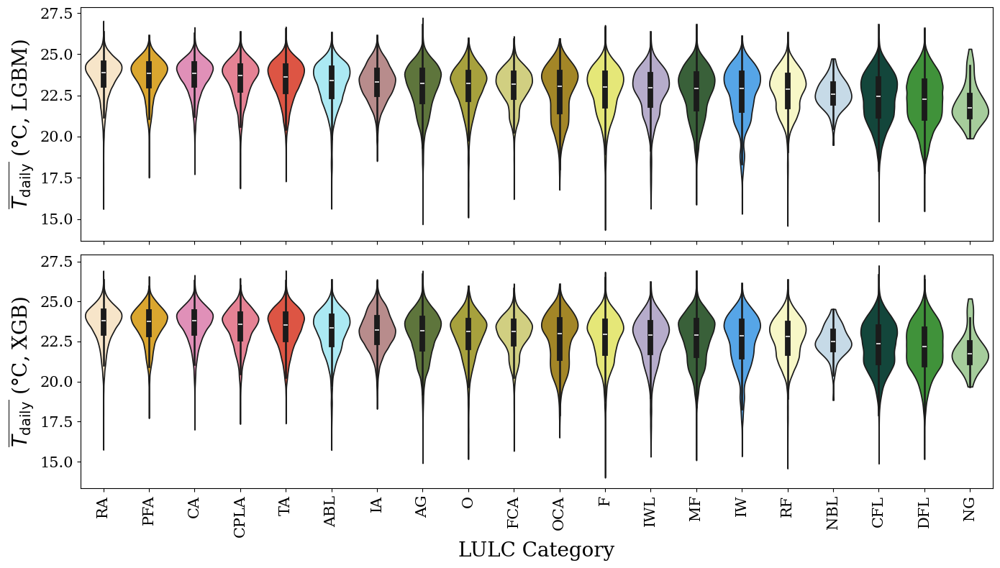

In [177]:
import matplotlib.colors as mcolors
import matplotlib.font_manager as fm

'''
font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'
font_name = fm.FontProperties(fname=font_path).get_name()
plt.rc('font', family=font_name)

# 한글이 깨지지 않도록 하기 위해서 minus 표시를 설정합니다.
plt.rcParams['axes.unicode_minus'] = False
'''
plt.rc('font', family='serif')

LGBM_flat = LGBM_mean.flatten()
XGB_flat = XGB_mean.flatten()
LULC_flat = Resampled_LULC.flatten()
LULC_flat[LULC_flat == 0] = np.nan

# Helper function to convert RGB fractions to hex
def rgb_to_hex(r, g, b):
    return mcolors.to_hex([r/255, g/255, b/255])

# Define the lulc_dict with RGB fractions and convert them to hex
lulc_dict = {
    110: ('RA', rgb_to_hex(254, 230, 194)),    # Residential Area
    120: ('IA', rgb_to_hex(192, 132, 132)),    # Industrial Area
    130: ('CA', rgb_to_hex(237, 131, 184)),    # Commercial Area
    140: ('CPLA', rgb_to_hex(246, 113, 138)),  # Cultural Physical Leisure Area
    150: ('TA', rgb_to_hex(247, 65, 42)),      # Transportational Area
    160: ('PFA', rgb_to_hex(246, 177, 18)),    # Public Facility Area
    
    210: ('RF', rgb_to_hex(255, 255, 191)),    # Rice Field
    220: ('F', rgb_to_hex(247, 249, 102)),     # Field
    230: ('FCA', rgb_to_hex(223, 220, 115)),   # Facility Cultivation Area
    240: ('O', rgb_to_hex(184, 177, 44)),      # Orchard
    250: ('OCA', rgb_to_hex(184, 145, 18)),    # Other Cultivation Area
    
    310: ('DFL', rgb_to_hex(51, 160, 44)),     # Deciduous forest land
    320: ('CFL', rgb_to_hex(10, 79, 64)),      # Coniferous forest land
    330: ('MF', rgb_to_hex(51, 102, 51)),      # Mixed forest
    
    410: ('NG', rgb_to_hex(161, 213, 148)),    # Natural grassland
    420: ('AG', rgb_to_hex(96, 126, 51)),      # Artificial grassland
    
    510: ('IWL', rgb_to_hex(180, 167, 208)),   # Inland wet land
    
    610: ('NBL', rgb_to_hex(193, 219, 236)),   # Natural bare land
    620: ('ABL', rgb_to_hex(159, 242, 255)),   # Artificial bare land
    
    710: ('IW', rgb_to_hex(62, 167, 255)),     # Inland water
    9999: ('nan', rgb_to_hex(255, 255, 255))
}

# Replace NaN values from LGBM_flat and XGB_flat
valid_indices = ~np.isnan(LGBM_flat) & ~np.isnan(XGB_flat) & ~np.isnan(LULC_flat)
LGBM_flat = LGBM_flat[valid_indices]
XGB_flat = XGB_flat[valid_indices]
LULC_flat = LULC_flat[valid_indices]


# Create a DataFrame to organize the new data
data = pd.DataFrame({
    'LULC': LULC_flat.astype(int),
    'LGBM': LGBM_flat,
    'XGB': XGB_flat
})

# Replace LULC numeric values with their corresponding names
data['LULC'] = data['LULC'].map({k: v[0] for k, v in lulc_dict.items() if k != 0})

# Calculate median values for LGBM and XGB for each LULC category and sort the categories
median_LGBM = data.groupby('LULC')['LGBM'].median().sort_values(ascending=False)
sorted_LULC = median_LGBM.index

# Map LULC to the sorted categories
data['LULC'] = pd.Categorical(data['LULC'], categories=sorted_LULC, ordered=True)

# Create a custom color palette using the LULC color dictionary
palette = {v[0]: v[1] for k, v in lulc_dict.items() if k != 0}

# Create the figure and the subplots
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 8), sharex=True)

# Plot LGBM violin plot with a reversed Blues color palette
sns.violinplot(x='LULC', y='LGBM', data=data, ax=ax1, palette=palette, legend=False, cut=0, scale='width')
ax1.set_xlabel('')
ax1.set_ylabel('$\overline{T_{\mathrm{daily}}}$ ($\degree$C, LGBM)', fontsize=20)

# Plot XGB violin plot with a custom color palette
sns.violinplot(x='LULC', y='XGB', data=data, ax=ax2, palette=palette, legend=False, cut=0, scale='width')
ax2.set_xlabel('LULC Category', fontsize=20)
ax2.set_ylabel('$\overline{T_{\mathrm{daily}}}$ ($\degree$C, XGB)', fontsize=20)

# Rotate x labels for better readability
plt.xticks(rotation=90)

# Remove titles
ax1.set_title('')
ax2.set_title('')

# Adjust the spacing between subplots
plt.subplots_adjust(hspace=0)  # Remove space between plots

plt.tight_layout()
# Save the figure (optional)
plt.savefig(f'Figures/LGBM_XGB_LULC_violin.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

In [178]:
from scipy import ndimage
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import ListedColormap
from matplotlib import cm
from matplotlib.colors import Normalize
from scipy.interpolate import interpn
import matplotlib.ticker as ticker

import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.mpl.gridliner as gridliner

import rasterio
from rasterio.plot import show
from tqdm import tqdm
from PIL import Image
import rioxarray

def plot_LULC_map(longitude, latitude, values, projection='PlateCarree', bounds=None, points=None, save_fig_path=None):
    # Create a colormap from the defined colors
    max_value = max(lulc_dict.keys())
    cmap_colors = [lulc_dict[i][1] for i in sorted(lulc_dict)]
    labels = [lulc_dict[i][0] for i in sorted(lulc_dict)]
    cmap = ListedColormap(cmap_colors)

    fig, ax = plt.subplots(figsize=(10, 10), subplot_kw={'projection': getattr(ccrs, projection)()}, dpi=150)

    # Set geographic bounds if specified
    if bounds:
        ax.set_extent(bounds, crs=ccrs.PlateCarree())

    # Add map features
    ax.add_feature(cfeature.LAND, facecolor='lightgray')
    ax.add_feature(cfeature.OCEAN, facecolor='azure')
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS, linestyle=':')

    print(np.unique(values))
    # Plot the data
    mesh = ax.pcolormesh(longitude, latitude, values, cmap=cmap, transform=ccrs.PlateCarree())

    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=1, color='black', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    gl.xformatter = gridliner.LONGITUDE_FORMATTER
    gl.yformatter = gridliner.LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 15, 'color': 'black'}
    gl.ylabel_style = {'size': 15, 'color': 'black'}

    # Create legend patches for detailed legend
    legend_patches = [mpatches.Patch(color=cmap_colors[i], label=labels[i]) for i in range(len(labels))]
    # Display the legend in 4 columns as requested
    legend = ax.legend(handles=legend_patches, title='Land Cover Classes', loc='upper center', bbox_to_anchor=(0.5, -0.1), fancybox=True, shadow=False, ncol=3)
    
    if points:
        for point in points:
            pixel_y, pixel_x = point
            ax.plot(pixel_x, pixel_y, marker='*', color='black', markersize=10, transform=ccrs.PlateCarree())
    
    if save_fig_path != None:
        plt.tight_layout()
        plt.savefig(save_fig_path, dpi=300, bbox_inches='tight')

    plt.show()

[(35.1144, 126.9974), (35.1008, 126.8985), (35.1289, 126.7452), (35.1368, 126.9288), (35.2303, 126.8408), (35.1316, 126.8813)]
[110. 120. 130. 140. 150. 160. 210. 220. 230. 240. 250. 310. 320. 330.
 410. 420. 510. 610. 620. 710.  nan]


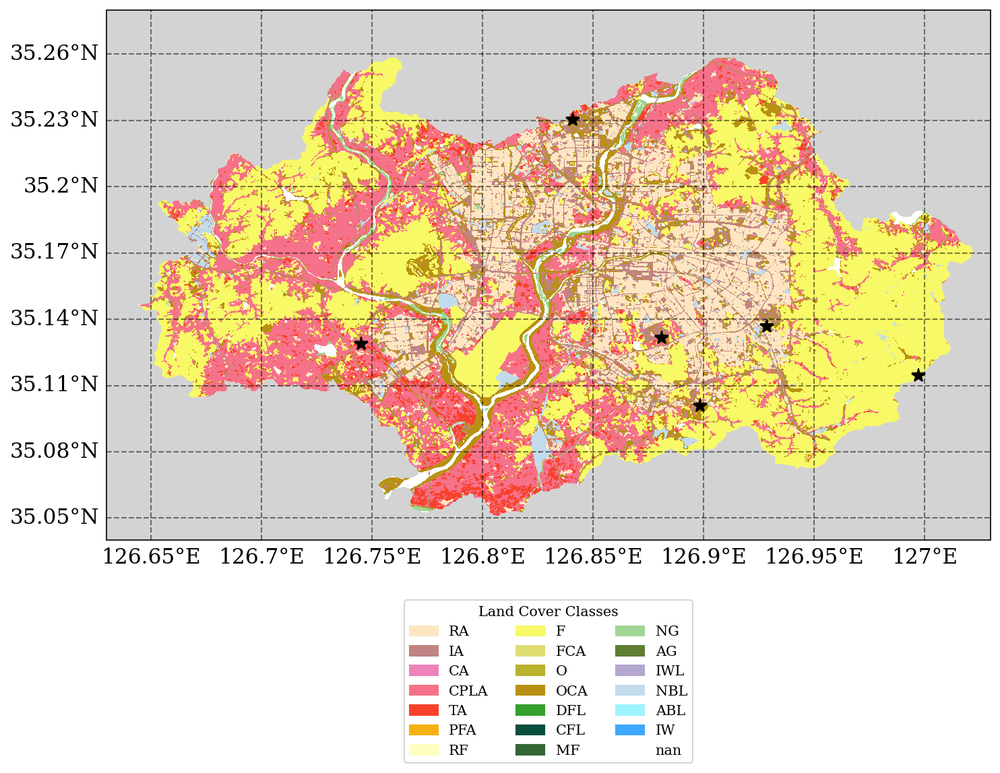

In [180]:
insitu_dict = {
    316:(35.1144, 126.9974), # MDS  
    689:(35.1008, 126.8985), # GJNG 
    708:(35.1289, 126.7452), # GS   
    722:(35.1368, 126.9288), # JSD  
    783:(35.2303, 126.8408), # GGW  
    788:(35.1316, 126.8813)  # PA   
}


select_point_list = [insitu_dict[316], insitu_dict[689], insitu_dict[708], insitu_dict[722], insitu_dict[783], insitu_dict[788]]
print(select_point_list)

Resampled_LULC[Resampled_LULC == np.nan] = 0

plot_LULC_map(longitude, latitude_ud, Resampled_LULC,
              points=select_point_list,
              save_fig_path=f'Figures/LULC_map.png')